# Generazione Template Termici per REMIR

Questo notebook crea template termici statici dai file sky-subtracted di una notte.

I template vengono salvati come:
```
{FILTER}_dither{ANGLE}_exptime{SEC}_thermal.fits
```

nella cartella `data_2026/` (o quella configurata nel config.yaml).

In [1]:
import os
import numpy as np
import glob
from collections import defaultdict
from astropy.io import fits
from astropy.stats import sigma_clip
from scipy.ndimage import median_filter
import matplotlib.pyplot as plt

print("Librerie caricate!")

Librerie caricate!


## 1. Configurazione

Modifica questi parametri secondo le tue esigenze:

In [3]:
# ===== CONFIGURA QUI =====

# Cartella con i file sky-subtracted (output della pipeline, cartella tmp/old o tmp/new)
INPUT_FOLDER = "../../../../../../../../Volumes/WD/MF/GRB/REM/thermal_REMIR_2021/Imgs_3858158_bc2/**/proc/tmp/old/"  # <-- MODIFICA QUESTO

# Cartella output per i template (dove sono i flat)
OUTPUT_FOLDER = "new_thermal_2021"

# Parametri
MIN_FRAMES = 10       # Minimo frame per costruire un template
SIGMA_CLIP = 3.0      # Sigma per il clipping (rimuove sorgenti astronomiche)

# Filtri da processare
FILTERS = ['J', 'H', 'K']

print(f"Input: {INPUT_FOLDER}")
print(f"Output: {OUTPUT_FOLDER}")

Input: ../../../../../../../../Volumes/WD/MF/GRB/REM/thermal_REMIR_2021/Imgs_3858158_bc2/**/proc/tmp/old/
Output: new_thermal_2021


## 2. Funzioni Utility

In [4]:
import glob

def get_dither_angle(header):
    """Estrae dither angle dall'header, gestendo old/new system."""
    if 'DITHANGL' in header:
        angle = header['DITHANGL']
    elif 'DWANGLE' in header:
        angle = (header['DWANGLE'] - 72.0) % 360
    else:
        angle = 0.0
    # Arrotonda al più vicino angolo atteso
    return int(round(angle / 72.0) * 72) % 360


def find_skysub_files(folder_pattern):
    """Trova tutti i file _skysub.fits, supporta pattern glob con **."""
    files = []
    
    # Usa glob per espandere il pattern (supporta **)
    search_pattern = os.path.join(folder_pattern, '*_skysub.fits')
    matching_files = glob.glob(search_pattern, recursive=True)
    
    print(f"  Pattern: {search_pattern}")
    print(f"  Trovati {len(matching_files)} file...")
    
    for fpath in matching_files:
        try:
            with fits.open(fpath) as hdul:
                header = hdul[0].header
                data = hdul[0].data
                
                filt = header.get('FILTER', 'UNK').strip().upper()
                dither = get_dither_angle(header)
                exptime = int(round(header.get('EXPTIME', 1.0)))
                
                files.append({
                    'path': fpath,
                    'filter': filt,
                    'dither': dither,
                    'exptime': exptime,
                    'data': data.astype(np.float32)
                })
        except Exception as e:
            print(f"Errore leggendo {os.path.basename(fpath)}: {e}")
    return files

print("Funzioni definite!")

Funzioni definite!


## 3. Carica e Raggruppa File

In [5]:
# Trova tutti i file
print(f"Cercando file in {INPUT_FOLDER}...")
all_files = find_skysub_files(INPUT_FOLDER)
print(f"Trovati {len(all_files)} file _skysub.fits")

# Raggruppa per filter × dither × exptime
groups = defaultdict(list)
for f in all_files:
    if f['filter'] in FILTERS:
        key = (f['filter'], f['dither'], f['exptime'])
        groups[key].append(f)

# Report
print("\nGruppi trovati:")
print("-" * 50)
for key in sorted(groups.keys()):
    filt, dither, exptime = key
    n = len(groups[key])
    status = "✓" if n >= MIN_FRAMES else f"✗ (serve {MIN_FRAMES})"
    print(f"  {filt} @ {dither:3d}° | {exptime:3d}s | {n:3d} frames | {status}")

Cercando file in ../../../../../../../../Volumes/WD/MF/GRB/REM/thermal_REMIR_2021/Imgs_3858158_bc2/**/proc/tmp/old/...
  Pattern: ../../../../../../../../Volumes/WD/MF/GRB/REM/thermal_REMIR_2021/Imgs_3858158_bc2/**/proc/tmp/old/*_skysub.fits
  Trovati 3769 file...
Trovati 3769 file _skysub.fits

Gruppi trovati:
--------------------------------------------------
  H @   0° |   1s |  53 frames | ✓
  H @   0° |   2s |   4 frames | ✗ (serve 10)
  H @   0° |   3s |  29 frames | ✓
  H @   0° |   5s |  16 frames | ✓
  H @   0° |  10s |   6 frames | ✗ (serve 10)
  H @   0° |  15s |  24 frames | ✓
  H @   0° |  30s |  19 frames | ✓
  H @   0° |  60s |   3 frames | ✗ (serve 10)
  H @  72° |   1s |  53 frames | ✓
  H @  72° |   2s |   4 frames | ✗ (serve 10)
  H @  72° |   3s |  29 frames | ✓
  H @  72° |   5s |  16 frames | ✓
  H @  72° |  10s |   6 frames | ✗ (serve 10)
  H @  72° |  15s |  24 frames | ✓
  H @  72° |  30s |  19 frames | ✓
  H @  72° |  60s |   3 frames | ✗ (serve 10)
  H @ 144°

## 4. Costruisci Template Termici

In [6]:
import sep

# Crea cartella output se non esiste
os.makedirs(OUTPUT_FOLDER, exist_ok=True)

templates_created = []

for key in sorted(groups.keys()):
    filt, dither, exptime = key
    frames = groups[key]
    
    if len(frames) < MIN_FRAMES:
        print(f"⏭️  {filt} @ {dither}° | {exptime}s: solo {len(frames)} frame, skip")
        continue
    
    print(f"🔨 {filt} @ {dither}° | {exptime}s: costruisco da {len(frames)} frame...")
    
    # Stack con mascheramento sorgenti
    masked_frames = []
    n_sources_total = 0
    
    for f in frames:
        data = f['data'].copy()
        
        # Detect sources con SEP - assicura byte order nativo
        data_bkg = (data - np.nanmedian(data)).astype(np.float32)
        data_sep = np.ascontiguousarray(data_bkg)
        
        try:
            bkg = sep.Background(data_sep)
            data_sub = data_sep - bkg
            objects = sep.extract(data_sub, thresh=3.0, err=bkg.globalrms)
            
            # Maschera le sorgenti (cerchi di raggio 5 pixel)
            mask = np.zeros(data.shape, dtype=bool)
            for obj in objects:
                y, x = int(obj['y']), int(obj['x'])
                r = 5
                yy, xx = np.ogrid[-r:r+1, -r:r+1]
                circle = xx**2 + yy**2 <= r**2
                y0, y1 = max(0, y-r), min(data.shape[0], y+r+1)
                x0, x1 = max(0, x-r), min(data.shape[1], x+r+1)
                mask[y0:y1, x0:x1] |= circle[:y1-y0, :x1-x0]
            
            data[mask] = np.nan
            n_sources_total += len(objects)
        except Exception as e:
            pass  # Se fallisce, usa frame originale
        
        masked_frames.append(data)
    
    # Stack nanmedian (ignora i NaN delle sorgenti mascherate)
    cube = np.array(masked_frames)
    template = np.nanmedian(cube, axis=0).astype(np.float32)
    
    # Riempi eventuali NaN residui con interpolazione locale
    from scipy.ndimage import generic_filter
    nan_mask = np.isnan(template)
    if nan_mask.any():
        template[nan_mask] = generic_filter(
            np.where(nan_mask, 0, template), 
            np.nanmedian, size=11
        )[nan_mask]
    
    # Salva
    filename = f"{filt}_dither{dither}_exptime{exptime}_thermal.fits"
    filepath = os.path.join(OUTPUT_FOLDER, filename)
    
    hdr = fits.Header()
    hdr['FILTER'] = filt
    hdr['DITHANGL'] = dither
    hdr['EXPTIME'] = exptime
    hdr['NFRAMES'] = len(frames)
    hdr['CALTYPE'] = 'THERMAL'
    hdr['COMMENT'] = 'Thermal template for dither wedge correction'
    
    fits.writeto(filepath, template, hdr, overwrite=True)
    templates_created.append((key, filepath))
    avg_sources = n_sources_total // len(frames)
    print(f"   ✅ Salvato: {filename} (~{avg_sources} sources/frame masked)")

print(f"\n{'='*50}")
print(f"Creati {len(templates_created)} template termici in {OUTPUT_FOLDER}/")

🔨 H @ 0° | 1s: costruisco da 53 frame...


/var/folders/2x/v6vt82kx6r59kylrhrmrcvhc0000gn/T/ipykernel_4800/500208855.py:54: RuntimeWarning: All-NaN slice encountered
  template = np.nanmedian(cube, axis=0).astype(np.float32)


   ✅ Salvato: H_dither0_exptime1_thermal.fits (~312 sources/frame masked)
⏭️  H @ 0° | 2s: solo 4 frame, skip
🔨 H @ 0° | 3s: costruisco da 29 frame...
   ✅ Salvato: H_dither0_exptime3_thermal.fits (~75 sources/frame masked)
🔨 H @ 0° | 5s: costruisco da 16 frame...
   ✅ Salvato: H_dither0_exptime5_thermal.fits (~59 sources/frame masked)
⏭️  H @ 0° | 10s: solo 6 frame, skip
🔨 H @ 0° | 15s: costruisco da 24 frame...
   ✅ Salvato: H_dither0_exptime15_thermal.fits (~51 sources/frame masked)
🔨 H @ 0° | 30s: costruisco da 19 frame...
   ✅ Salvato: H_dither0_exptime30_thermal.fits (~191 sources/frame masked)
⏭️  H @ 0° | 60s: solo 3 frame, skip
🔨 H @ 72° | 1s: costruisco da 53 frame...
   ✅ Salvato: H_dither72_exptime1_thermal.fits (~302 sources/frame masked)
⏭️  H @ 72° | 2s: solo 4 frame, skip
🔨 H @ 72° | 3s: costruisco da 29 frame...
   ✅ Salvato: H_dither72_exptime3_thermal.fits (~73 sources/frame masked)
🔨 H @ 72° | 5s: costruisco da 16 frame...
   ✅ Salvato: H_dither72_exptime5_thermal.f

   ✅ Salvato: K_dither0_exptime3_thermal.fits (~66 sources/frame masked)
🔨 K @ 0° | 5s: costruisco da 19 frame...
   ✅ Salvato: K_dither0_exptime5_thermal.fits (~40 sources/frame masked)
⏭️  K @ 0° | 10s: solo 6 frame, skip
🔨 K @ 0° | 15s: costruisco da 268 frame...
   ✅ Salvato: K_dither0_exptime15_thermal.fits (~22 sources/frame masked)
⏭️  K @ 0° | 60s: solo 3 frame, skip
🔨 K @ 72° | 1s: costruisco da 52 frame...
   ✅ Salvato: K_dither72_exptime1_thermal.fits (~271 sources/frame masked)
⏭️  K @ 72° | 2s: solo 4 frame, skip
🔨 K @ 72° | 3s: costruisco da 29 frame...
   ✅ Salvato: K_dither72_exptime3_thermal.fits (~65 sources/frame masked)
🔨 K @ 72° | 5s: costruisco da 19 frame...
   ✅ Salvato: K_dither72_exptime5_thermal.fits (~47 sources/frame masked)
⏭️  K @ 72° | 10s: solo 6 frame, skip
🔨 K @ 72° | 15s: costruisco da 268 frame...
   ✅ Salvato: K_dither72_exptime15_thermal.fits (~31 sources/frame masked)
⏭️  K @ 72° | 60s: solo 3 frame, skip
🔨 K @ 144° | 1s: costruisco da 52 frame..

## 5. Visualizza Template (Opzionale)

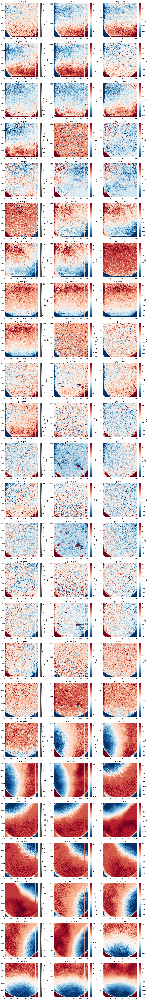

In [7]:
# Visualizza i template creati
if templates_created:
    n_templates = len(templates_created)
    cols = min(3, n_templates)
    rows = (n_templates + cols - 1) // cols
    
    fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 4*rows))
    if n_templates == 1:
        axes = [axes]
    else:
        axes = axes.flatten()
    
    for idx, ((filt, dither, exptime), fpath) in enumerate(templates_created):
        data = fits.getdata(fpath)
        ax = axes[idx]
        
        vmin, vmax = np.nanpercentile(data, [5, 95])
        im = ax.imshow(data, origin='lower', cmap='RdBu_r', vmin=vmin, vmax=vmax)
        ax.set_title(f"{filt} @ {dither}° | {exptime}s")
        plt.colorbar(im, ax=ax, label='ADU')
    
    # Nascondi assi vuoti
    for idx in range(n_templates, len(axes)):
        axes[idx].axis('off')
    
    plt.tight_layout()
    plt.show()
else:
    print("Nessun template creato.")

## 6. Verifica Consistenza tra Exptime (Opzionale)

Questa cella confronta i template a diversi exptime per verificare che scalino linearmente.

In [8]:
# Raggruppa template per filter × dither
from collections import defaultdict

by_filter_dither = defaultdict(list)
for (filt, dither, exptime), fpath in templates_created:
    by_filter_dither[(filt, dither)].append((exptime, fpath))

print("Verifica linearità (thermal ∝ exptime):")
print("-" * 60)

for (filt, dither), items in sorted(by_filter_dither.items()):
    if len(items) < 2:
        continue
    
    items.sort()  # ordina per exptime
    exptimes = [x[0] for x in items]
    
    # Calcola "forza" del pattern come deviazione standard (o range interquartile)
    ref_exp, ref_path = items[0]
    ref_data = fits.getdata(ref_path)
    ref_std = np.nanstd(ref_data)  # Misura la variazione del pattern
    
    print(f"\n{filt} @ {dither}°:")
    print(f"  Riferimento: {ref_exp}s (std = {ref_std:.2f} ADU)")
    
    for exp, fpath in items[1:]:
        data = fits.getdata(fpath)
        std = np.nanstd(data)
        
        expected_ratio = exp / ref_exp
        actual_ratio = std / ref_std if ref_std > 0 else 0
        diff_pct = abs(actual_ratio - expected_ratio) / expected_ratio * 100 if expected_ratio > 0 else 0
        
        status = "✓" if diff_pct < 30 else "⚠️"
        print(f"  {exp}s: std={std:.2f} ADU, atteso ×{expected_ratio:.2f}, misurato ×{actual_ratio:.2f} (diff {diff_pct:.1f}%) {status}")

Verifica linearità (thermal ∝ exptime):
------------------------------------------------------------

H @ 0°:
  Riferimento: 1s (std = 3.98 ADU)
  3s: std=19.73 ADU, atteso ×3.00, misurato ×4.96 (diff 65.3%) ⚠️
  5s: std=40.32 ADU, atteso ×5.00, misurato ×10.13 (diff 102.7%) ⚠️
  15s: std=86.10 ADU, atteso ×15.00, misurato ×21.64 (diff 44.2%) ⚠️
  30s: std=200.54 ADU, atteso ×30.00, misurato ×50.39 (diff 68.0%) ⚠️

H @ 72°:
  Riferimento: 1s (std = 2.00 ADU)
  3s: std=7.67 ADU, atteso ×3.00, misurato ×3.85 (diff 28.2%) ✓
  5s: std=14.03 ADU, atteso ×5.00, misurato ×7.03 (diff 40.6%) ⚠️
  15s: std=29.87 ADU, atteso ×15.00, misurato ×14.97 (diff 0.2%) ✓
  30s: std=72.62 ADU, atteso ×30.00, misurato ×36.40 (diff 21.3%) ✓

H @ 144°:
  Riferimento: 1s (std = 0.99 ADU)
  3s: std=2.95 ADU, atteso ×3.00, misurato ×2.99 (diff 0.3%) ✓
  5s: std=5.43 ADU, atteso ×5.00, misurato ×5.50 (diff 10.1%) ✓
  15s: std=10.02 ADU, atteso ×15.00, misurato ×10.15 (diff 32.4%) ⚠️
  30s: std=20.35 ADU, atteso ×

## 7. Riepilogo

Per usare questi template statici nella pipeline, imposta nel `config.yaml`:

```yaml
calibration:
  enable_thermal_correction: true
  thermal_use_static: true  # <-- QUESTO!
```

I template saranno caricati automaticamente dalla cartella `data_2026/`.